## Setting up the environment (Runtime will restart)

In [1]:
!pip install wheel==0.42.0
!pip install torch==2.1.0 torchvision==0.16.0 --index-url https://download.pytorch.org/whl/cu121
!pip install git+https://github.com/qwertyroiro/segment_tools.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.4/65.4 kB 2.9 MB/s eta 0:00:00
  Attempting uninstall: wheel
    Found existing installation: wheel 0.43.0
    Uninstalling wheel-0.43.0:
      Successfully uninstalled wheel-0.43.0
Looking in indexes: https://download.pytorch.org/whl/cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 GB 695.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 91.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.2/89.2 MB 9.3 MB/s eta 0:00:00
  Attempting uninstall: triton
    Found existing installation: triton 2.2.0
    Uninstalling triton-2.2.0:
      Successfully uninstalled triton-2.2.0
  Attempting uninstall: torch
    Found existing installation: torch 2.2.1+cu121
    Uninstalling torch-2.2.1+cu121:
      Successfully uninstalled torch-2.2.1+cu121
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.17.1+cu121
    Uninstalling torchvision-0.17.1+cu121:
      Successful

## Setting up the environment (After the runtime is restarted, execute following)

In [1]:
!pip install natten==0.15.1 -f https://shi-labs.com/natten/wheels/cu121/torch2.1.0/index.html

Looking in links: https://shi-labs.com/natten/wheels/cu121/torch2.1.0/index.html


Exception in thread Thread-5 (attachment_entry):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/debugpy/server/api.py", line 237, in listen
    sock, _ = endpoints_listener.accept()
  File "/usr/lib/python3.10/socket.py", line 293, in accept
    fd, addr = self._accept()
TimeoutError: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/google/colab/_debugpy.py", line 52, in attachment_entry
    debugpy.listen(_dap_port)
  File "/usr/local/lib/python3.10/dist-packages/debugpy/public_api.py", line 31, in wrapper
    return wrapped(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/debugpy/server/api.py", line 143, in debug
    log.reraise

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 MB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.4/19.4 MB 42.3 MB/s eta 0:00:00
  Attempting uninstall: cmake
    Found existing installation: cmake 3.27.9
    Uninstalling cmake-3.27.9:
      Successfully uninstalled cmake-3.27.9


In [1]:
from PIL import Image
import numpy as np
import segment_tools as st
import torch

import locale
locale.getpreferredencoding = lambda: "UTF-8"

import logging
logging.getLogger("fvcore").setLevel(logging.ERROR)
logging.getLogger("detectron2").setLevel(logging.ERROR)
logging.getLogger("ultralytics").setLevel(logging.ERROR)
logging.getLogger("dinov2").setLevel(logging.ERROR)

Exception in thread Thread-5 (attachment_entry):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/debugpy/server/api.py", line 237, in listen
    sock, _ = endpoints_listener.accept()
  File "/usr/lib/python3.10/socket.py", line 293, in accept
    fd, addr = self._accept()
TimeoutError: timed out

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/local/lib/python3.10/dist-packages/google/colab/_debugpy.py", line 52, in attachment_entry
    debugpy.listen(_dap_port)
  File "/usr/local/lib/python3.10/dist-packages/debugpy/public_api.py", line 31, in wrapper
    return wrapped(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/debugpy/server/api.py", line 143, in debug
    log.reraise

## Images and Prompts

In [2]:
image_path = "cityscapes.png"
image_pil = Image.open(image_path)  # Open image with Pillow
image_np = np.array(image_pil)      # Convert to numpy array

In [3]:
prompt = "car"  # Define your prompt

## FastSAM

weights/FastSAM.pt not found. Downloading...


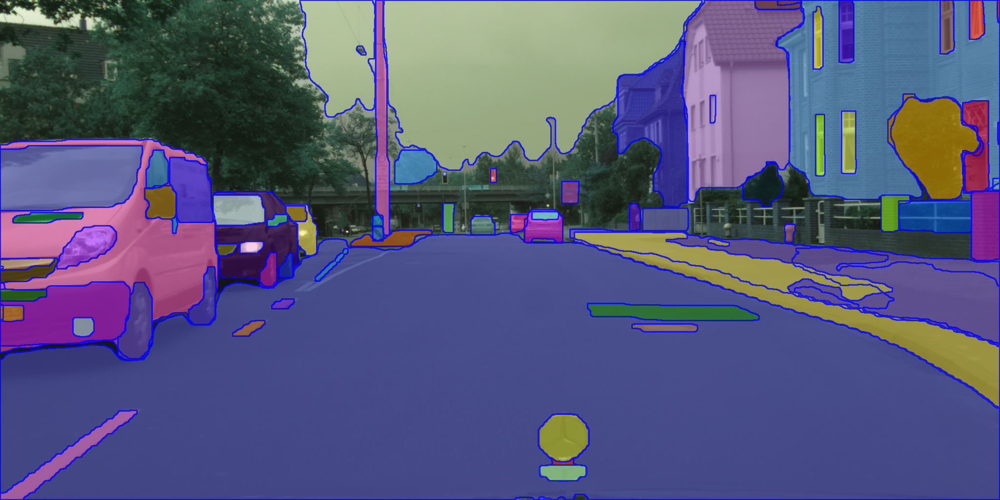

In [5]:
# Segment without prompt
fastsam = st.FastSAM()
result = fastsam.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

100%|███████████████████████████████████████| 338M/338M [00:05<00:00, 70.3MiB/s]


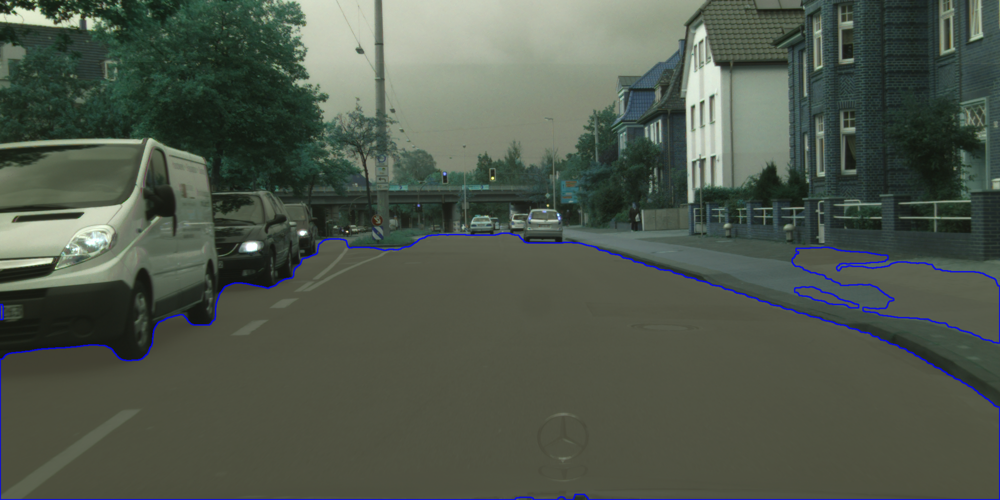

In [6]:
# Segment with prompt
fastsam = st.FastSAM()
result = fastsam.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [7]:
del fastsam
torch.cuda.empty_cache()

## CLIPSeg

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/380 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/974 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.73k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/603M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


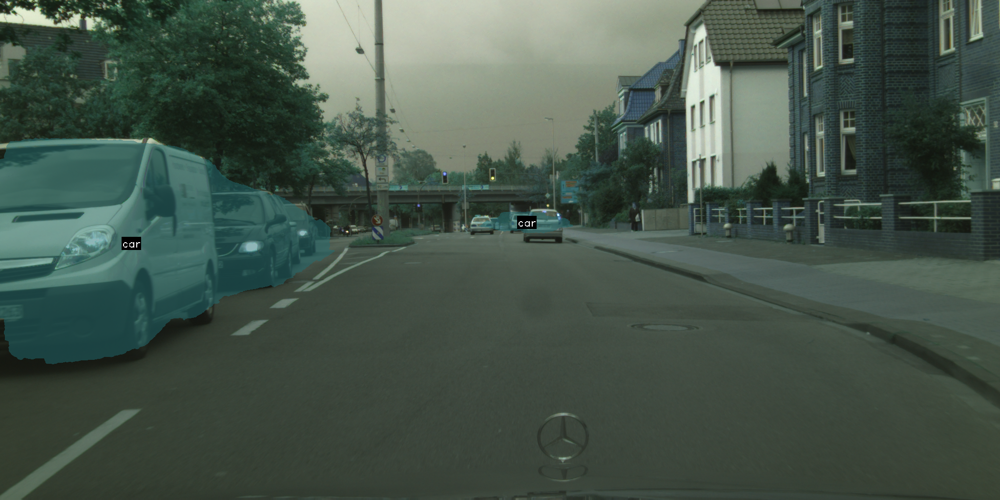

In [8]:
clipseg = st.CLIPSeg()
result = clipseg.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [9]:
del clipseg
torch.cuda.empty_cache()

## GroundingDINO

### Object Detection

GroundingDINO_SwinB.cfg.py:   0%|          | 0.00/1.01k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

groundingdino_swinb_cogcoor.pth:   0%|          | 0.00/938M [00:00<?, ?B/s]

Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swinb_cogcoor.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:995: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


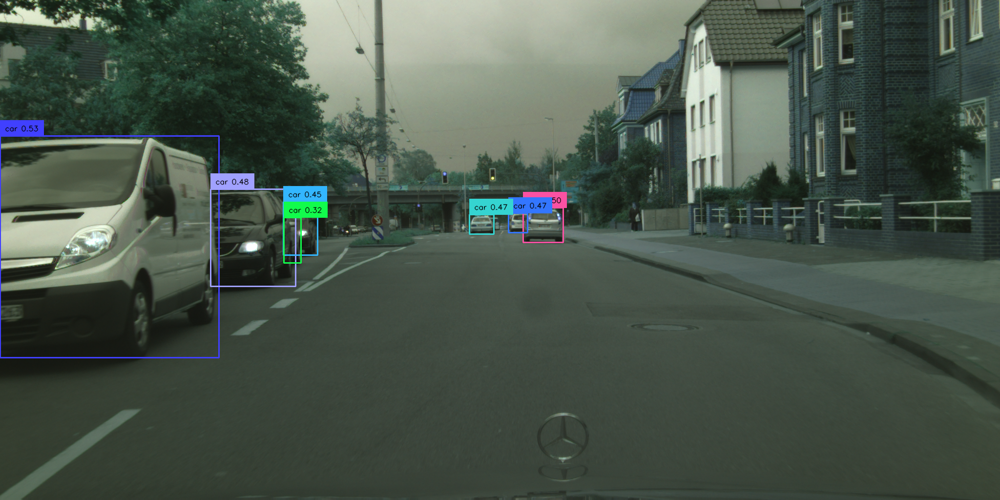

In [10]:
dino = st.DINO()
result = dino.run(image_np, prompt)
if result is not None:
    image, bbox = result["image"], result["bbox"]
Image.fromarray(image)

### segmentation

weights/sam_vit_h_4b8939.pth is not found. Downloading...
final text_encoder_type: bert-base-uncased
Model loaded from /root/.cache/huggingface/hub/models--ShilongLiu--GroundingDINO/snapshots/a94c9b567a2a374598f05c584e96798a170c56fb/groundingdino_swinb_cogcoor.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:995: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


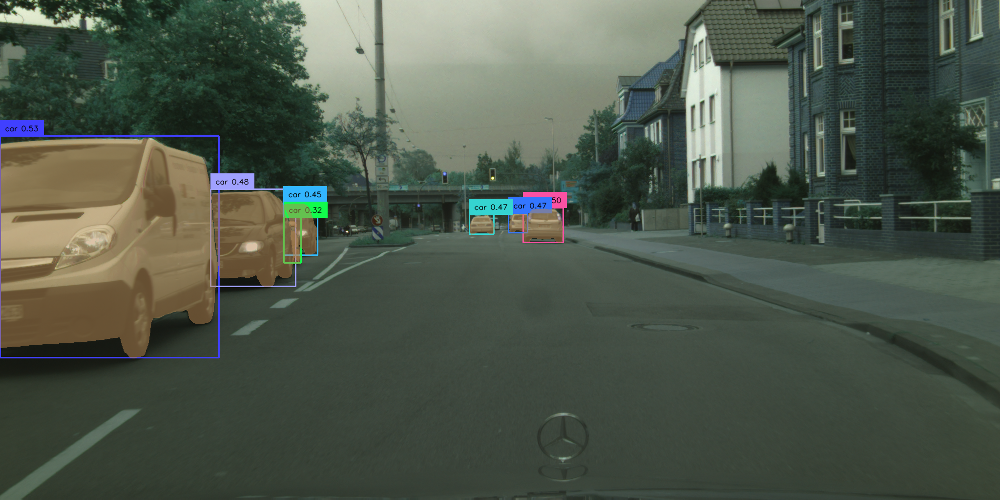

In [11]:
dinoseg = st.DINOSeg(sam_checkpoint="vit_h")
result = dinoseg.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [12]:
del dino, dinoseg
torch.cuda.empty_cache()

## OneFormer

### ADE20k

#### Backbone: DiNAT-L

weights/250_16_dinat_l_oneformer_ade20k_160k.pth not found. Downloading...


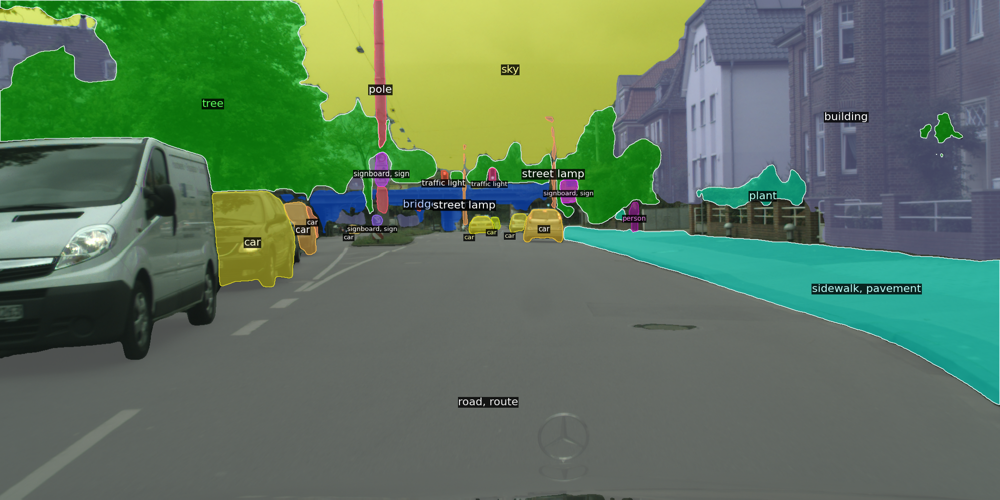

In [13]:
# Create Oneformer Instance(DiNAT-L)
oneformer_ade20k = st.OneFormer(dataset="ade20k")

# without prompt
result = oneformer_ade20k.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

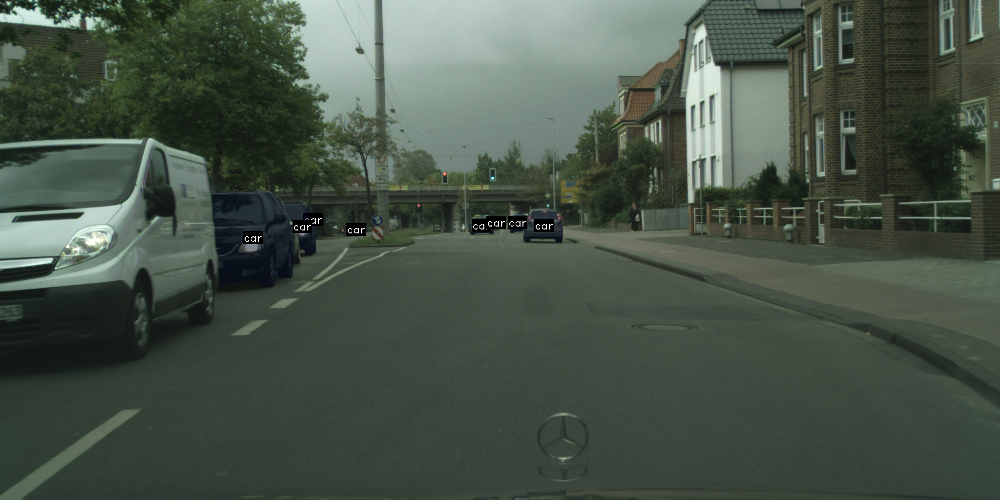

In [14]:
# Create Oneformer Instance(DiNAT-L)
oneformer_ade20k = st.OneFormer(dataset="ade20k")

# with prompt
result = oneformer_ade20k.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

#### Backbone: Swin-L

weights/250_16_swin_l_oneformer_ade20k_160k.pth not found. Downloading...


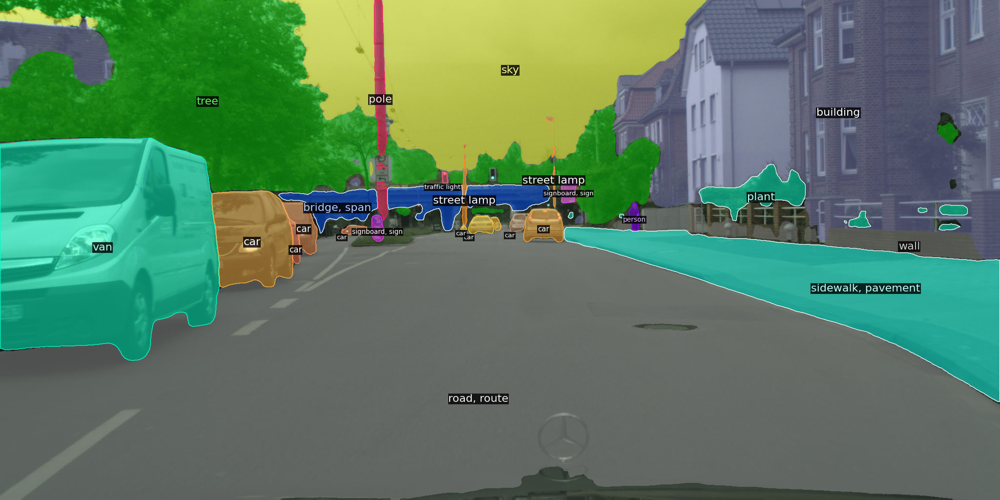

In [15]:
# Create Oneformer Instance(Swin-L)
oneformer_ade20k_swin = st.OneFormer(dataset="ade20k", use_swin=True)

# without prompt
result = oneformer_ade20k_swin.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

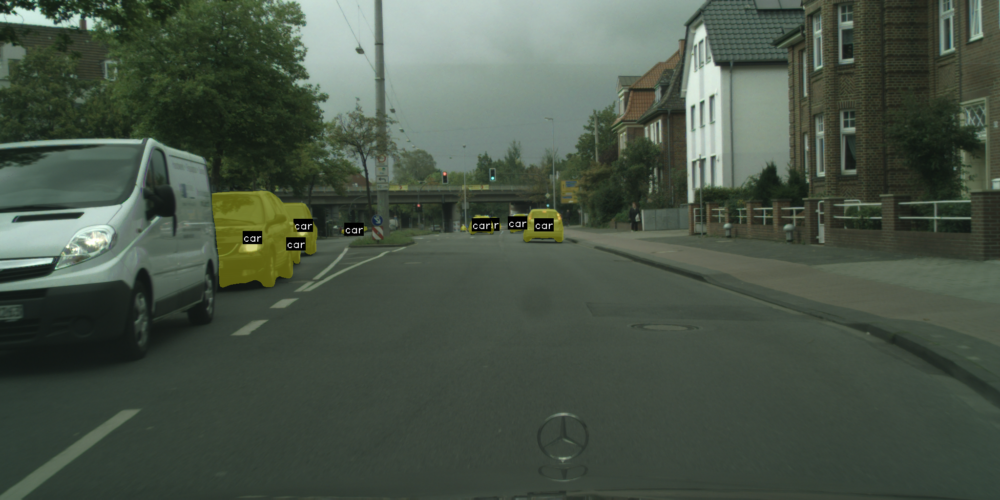

In [16]:
# Create Oneformer Instance(Swin-L)
oneformer_ade20k_swin = st.OneFormer(dataset="ade20k", use_swin=True)

# with prompt
result = oneformer_ade20k_swin.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [17]:
del oneformer_ade20k, oneformer_ade20k_swin
torch.cuda.empty_cache()

### CityScapes

#### Backbone: DiNAT-L

weights/250_16_dinat_l_oneformer_cityscapes_90k.pth not found. Downloading...


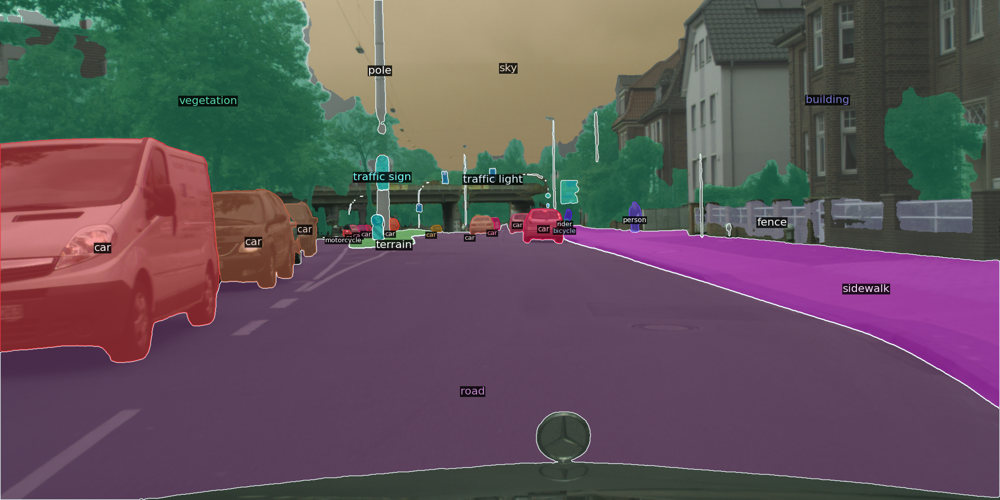

In [18]:
# Create Oneformer Instance(DiNAT-L)
oneformer_cityscapes = st.OneFormer(dataset="cityscapes")

# without prompt
result = oneformer_cityscapes.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

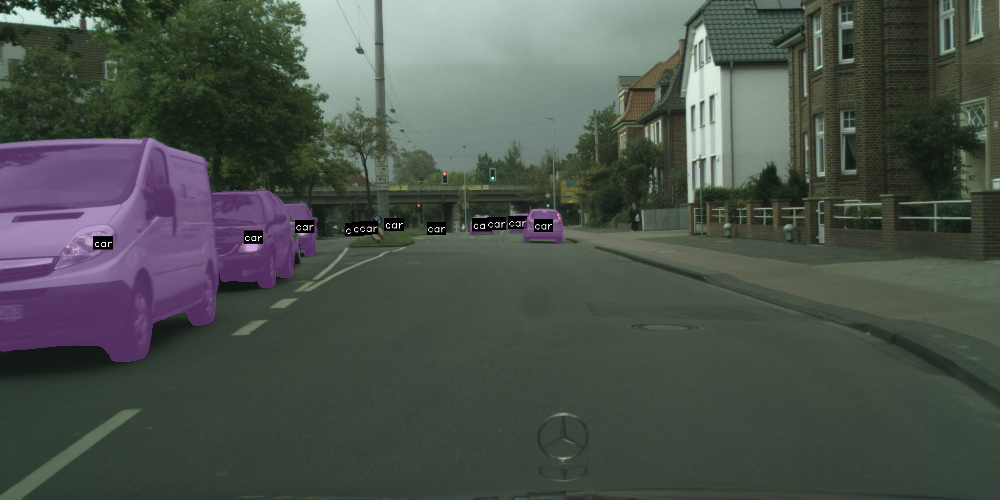

In [19]:
# Create Oneformer Instance(DiNAT-L)
oneformer_cityscapes = st.OneFormer(dataset="cityscapes")

# with prompt
result = oneformer_cityscapes.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

#### Backbone: Swin-L

weights/250_16_swin_l_oneformer_cityscapes_90k.pth not found. Downloading...


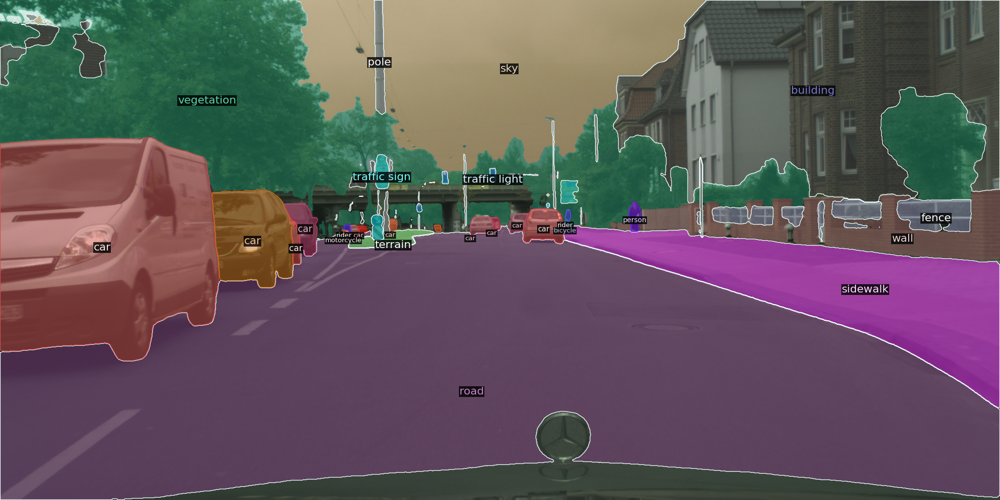

In [20]:
# Create Oneformer Instance(Swin-L)
oneformer_cityscapes_swin = st.OneFormer(dataset="cityscapes", use_swin=True)

# without prompt
result = oneformer_cityscapes_swin.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

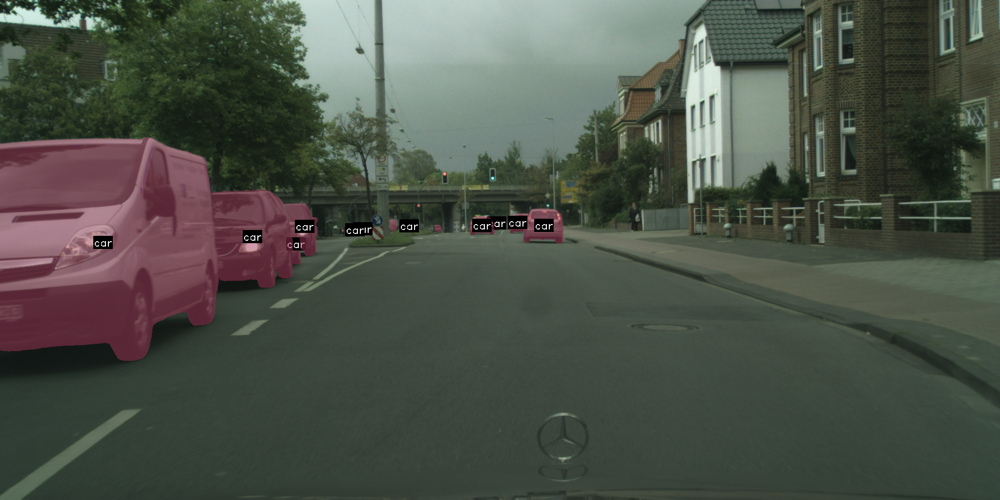

In [21]:
# Create Oneformer Instance(Swin-L)
oneformer_cityscapes_swin = st.OneFormer(dataset="cityscapes", use_swin=True)

# with prompt
result = oneformer_cityscapes_swin.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [22]:
del oneformer_cityscapes, oneformer_cityscapes_swin
torch.cuda.empty_cache()

### COCO

#### Backbone: DiNAT-L

weights/150_16_dinat_l_oneformer_coco_100ep.pth not found. Downloading...


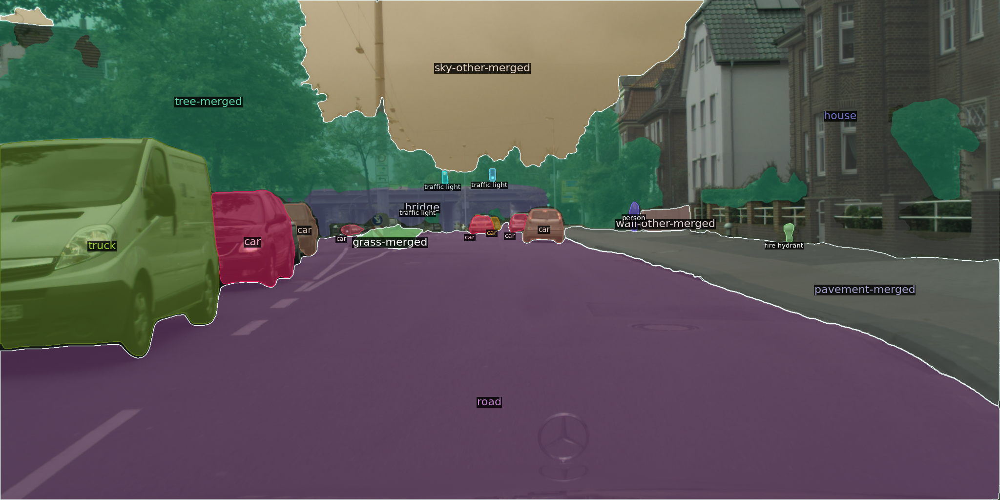

In [23]:
# Create Oneformer Instance(DiNAT-L)
oneformer_coco = st.OneFormer(dataset="coco")

# without prompt
result = oneformer_coco.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

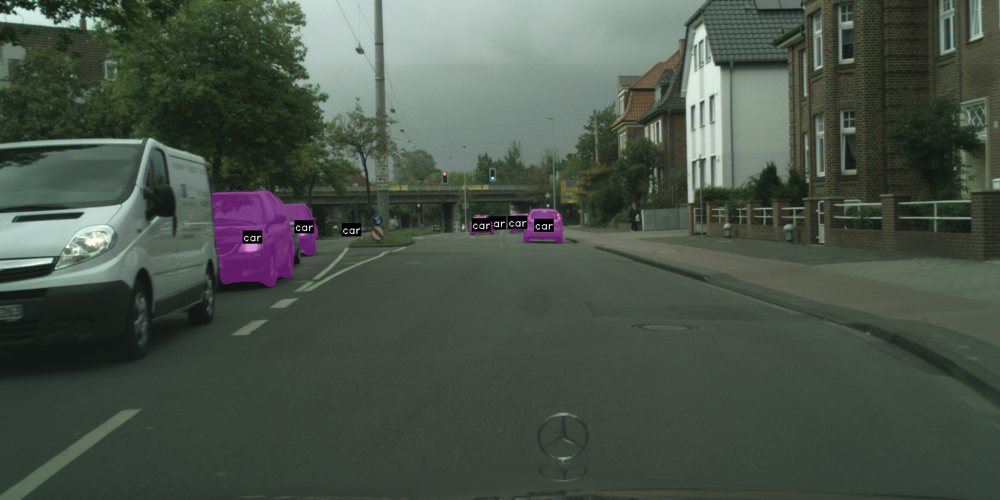

In [24]:
# Create Oneformer Instance(DiNAT-L)
oneformer_coco = st.OneFormer(dataset="coco")

# with prompt
result = oneformer_coco.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

#### Backbone: Swin-L

weights/150_16_swin_l_oneformer_coco_100ep.pth not found. Downloading...


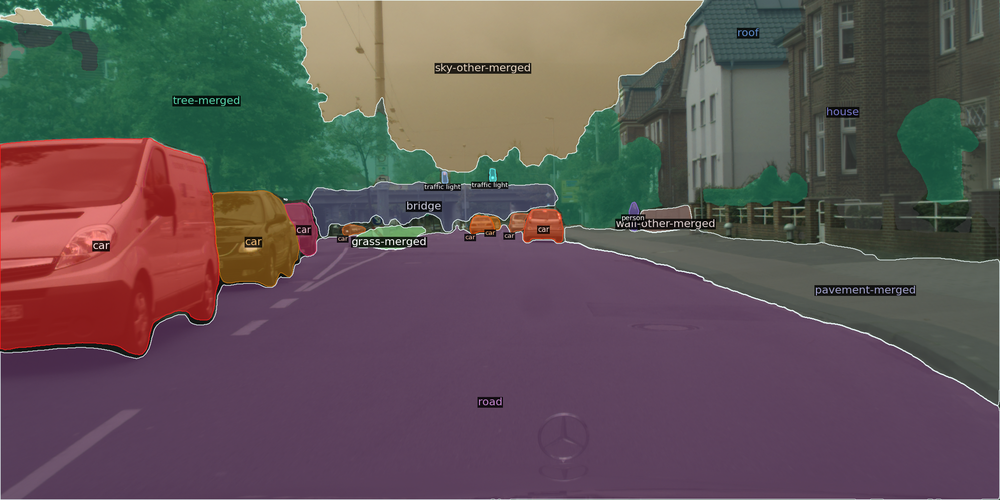

In [25]:
# Create Oneformer Instance(Swin-L)
oneformer_coco_swin = st.OneFormer(dataset="coco", use_swin=True)

# without prompt
result = oneformer_coco_swin.run(image_np)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

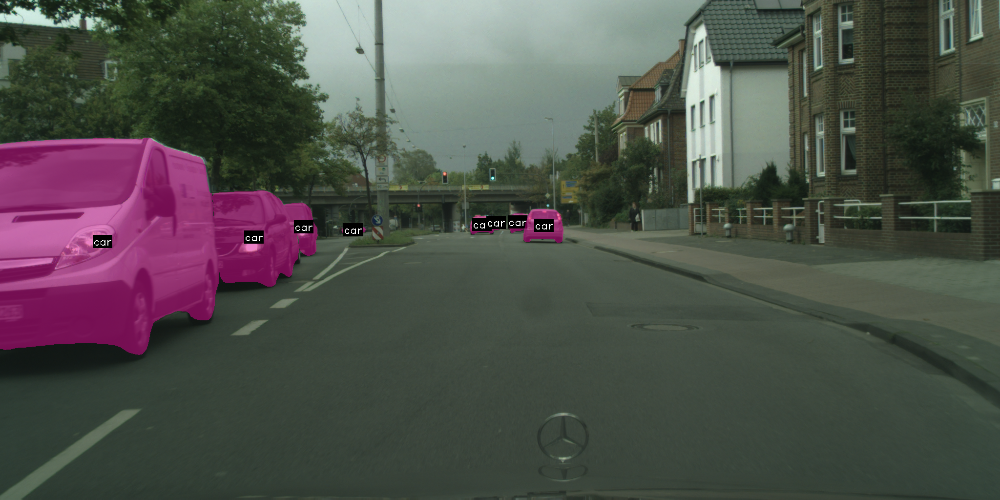

In [26]:
# Create Oneformer Instance(Swin-L)
oneformer_coco_swin = st.OneFormer(dataset="coco", use_swin=True)

# with prompt
result = oneformer_coco_swin.run(image_np, prompt)
if result is not None:
    image, ann = result["image"], result["mask"]
Image.fromarray(image)

In [27]:
del oneformer_coco, oneformer_coco_swin
torch.cuda.empty_cache()

## Depth Anything

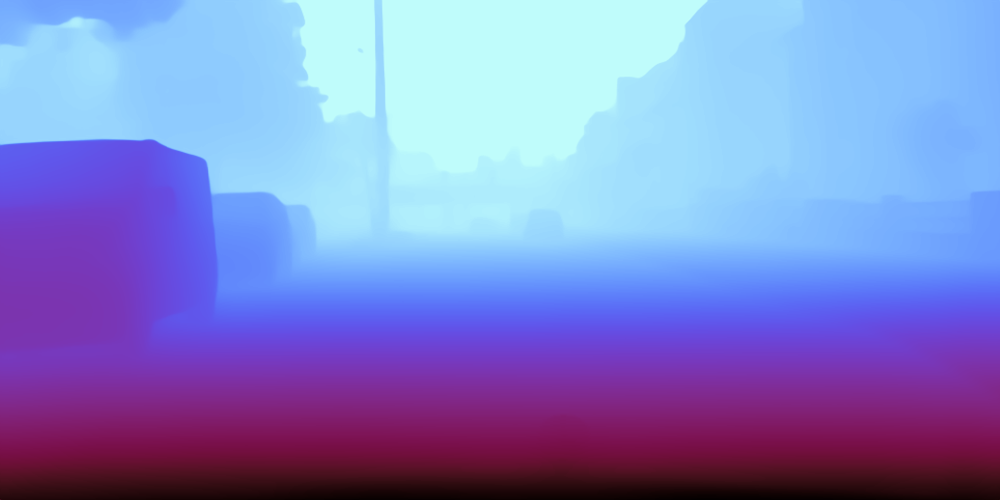

In [5]:
depth_model = st.Depth_Anything(encoder="vitb") # vits or vitb or vitl
result = depth_model.run(image_np)
if result is not None:
    image, depth = result["image"], result["depth"]
Image.fromarray(image)

In [6]:
del depth_model
torch.cuda.empty_cache()

## DINOv2 (depth estimation) (CPU is not supported)

Using cache found in /root/.cache/torch/hub/facebookresearch_dinov2_main
/usr/local/lib/python3.10/dist-packages/segment_tools/dinov2/dinov2/layers/swiglu_ffn.py:51: UserWarning: xFormers is not available (SwiGLU)
  warnings.warn("xFormers is not available (SwiGLU)")
/usr/local/lib/python3.10/dist-packages/segment_tools/dinov2/dinov2/layers/attention.py:33: UserWarning: xFormers is not available (Attention)
  warnings.warn("xFormers is not available (Attention)")
/usr/local/lib/python3.10/dist-packages/segment_tools/dinov2/dinov2/layers/block.py:40: UserWarning: xFormers is not available (Block)
  warnings.warn("xFormers is not available (Block)")


load checkpoint from http path: https://dl.fbaipublicfiles.com/dinov2/dinov2_vits14/dinov2_vits14_nyu_dpt_head.pth


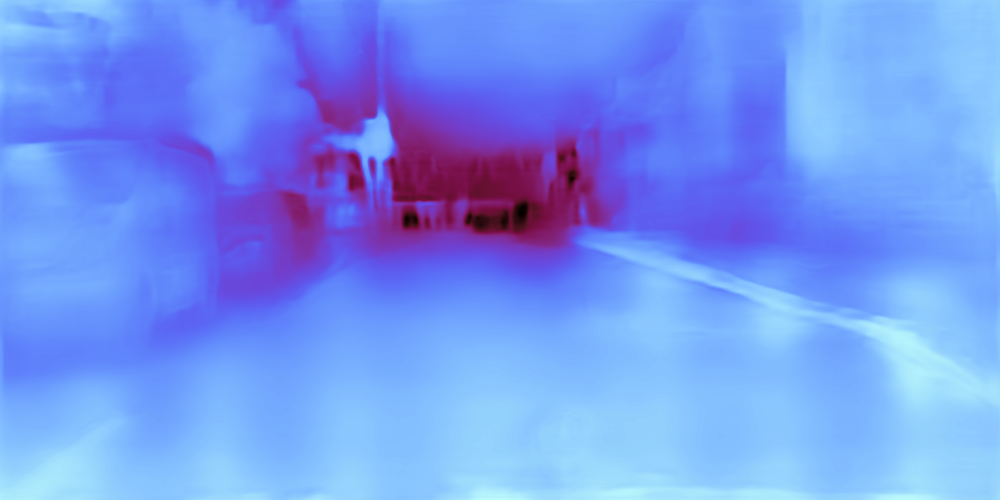

In [4]:
depth_model = st.DINOv2_depth(BACKBONE_SIZE="small") # small, base, large, giant
result = depth_model.run(image_np)
if result is not None:
    image, depth = result["image"], result["depth"]
Image.fromarray(image)

In [5]:
del depth_model
torch.cuda.empty_cache()